In [ ]:
!pip install roboflow torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 82.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 131.6 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11


In [ ]:
import os
import random
from glob import glob

import numpy as np
from PIL import Image

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF
from torchvision.models.segmentation import deeplabv3_resnet101
from torchvision.models.segmentation.deeplabv3 import DeepLabHead
from roboflow import Roboflow

rf = Roboflow(api_key="RLAhkpDgEitOujs7HlHy")
project = rf.workspace("segclass").project("dailyobjects-8oggm")
version = project.version(3)
dataset = version.download("png-mask-semantic")

DATA_ROOT = dataset.location

print("Dataset root:", DATA_ROOT)
print("Subfolders:", os.listdir(DATA_ROOT))

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to DailyObjects-3 in png-mask-semantic:: 100%|██████████| 402/402 [00:00<00:00, 8553.59it/s]

Dataset root: /content/DailyObjects-3
Subfolders: ['README.dataset.txt', 'test', 'valid', 'train', 'README.roboflow.txt']


In [ ]:
!mv /content/DailyObjects-3/train/test /content/DailyObjects-3

In [ ]:
import os
import shutil

source_dir = '/content/DailyObjects-3/test'
destination_dir = '/content/DailyObjects-3/train'

print(f"Moving contents from {source_dir} to {destination_dir}...")

os.makedirs(destination_dir, exist_ok=True)
for item in os.listdir(source_dir):
    s = os.path.join(source_dir, item)
    d = os.path.join(destination_dir, item)
    shutil.move(s, d)
    print(f"  Moved: {item}")

shutil.rmtree(source_dir)
print(f"Contents successfully moved. {source_dir} has been removed.")

Moving contents from /content/DailyObjects-3/test to /content/DailyObjects-3/train...
  Moved: socket-32-_JPG.rf.f4020566f3bb07066090133d915696dc_mask.png
  Moved: socket-10-_JPG.rf.10334e960b0f76b418cdef7263a6fab7_mask.png
  Moved: notice_board-68-_jpeg.rf.6957c574cb4eecfdb25129a80cad0d11_mask.png
  Moved: socket-13-_JPG.rf.f7f5693cff4585239ab5cbc4e9bb3825_mask.png
  Moved: socket-86-_JPG.rf.89d5ad10b8f8e7cf25abf7e22845cdca.jpg
  Moved: socket-99-_JPG.rf.36cc69e6e5a6b97b6eb71e9e898edc26_mask.png
  Moved: notice_board-68-_jpeg.rf.6957c574cb4eecfdb25129a80cad0d11.jpg
  Moved: notice_board-23-_jpeg.rf.6657c4841fc2e0fa1b1101be1ed1f577.jpg
  Moved: notice_board-37-_jpeg.rf.a72c2d8b54e59ca227d5f04a9094d24c.jpg
  Moved: notice_board-37-_jpeg.rf.a72c2d8b54e59ca227d5f04a9094d24c_mask.png
  Moved: socket-10-_JPG.rf.10334e960b0f76b418cdef7263a6fab7.jpg
  Moved: notice_board-23-_jpeg.rf.6657c4841fc2e0fa1b1101be1ed1f577_mask.png
  Moved: socket-99-_JPG.rf.36cc69e6e5a6b97b6eb71e9e898edc26.jpg
  Mov

In [ ]:
import os
import shutil
from glob import glob
from PIL import Image

splits = ["train", "valid"]

for split in splits:
    split_path = os.path.join(DATA_ROOT, split)
    images_path = os.path.join(split_path, "images")
    labels_path = os.path.join(split_path, "labels")

    os.makedirs(images_path, exist_ok=True)
    os.makedirs(labels_path, exist_ok=True)
    all_files = glob(os.path.join(split_path, "*.png")) + glob(os.path.join(split_path, "*.jpg"))

    print(f"\nProcessing split: {split}")
    print(f"Found {len(all_files)} potential image/mask files in {split_path}")

    for file_path in all_files:
        try:
            with Image.open(file_path) as img:
                file_name = os.path.basename(file_path)

                if img.mode == 'L':
                    destination_dir = labels_path
                elif img.mode in ['RGB', 'RGBA', 'P']:
                    destination_dir = images_path
                else:
                    print(f"  Skipping file {file_name} with unknown mode: {img.mode}")
                    continue

                destination_path = os.path.join(destination_dir, file_name)
                shutil.move(file_path, destination_path)

        except Exception as e:
            print(f"  Error processing {file_path}: {e}")

print("\nFile organization complete. You can now try loading the datasets again.")


Processing split: train
Found 334 potential image/mask files in /content/DailyObjects-3/train

Processing split: valid
Found 60 potential image/mask files in /content/DailyObjects-3/valid

Processing split: test
Found 0 potential image/mask files in /content/DailyObjects-3/test

File organization complete. You can now try loading the datasets again.


In [ ]:
import torchvision.transforms.functional as TF
import numpy as np
import random, torch
from PIL import Image, ImageFilter, ImageEnhance

class SegmentationAugmentations:
    def __init__(self, resize=(512, 512)):
        self.resize = resize

    def __call__(self, image, mask):
        if self.resize:
            image = TF.resize(image, self.resize, interpolation=TF.InterpolationMode.BILINEAR)
            mask  = TF.resize(mask,  self.resize, interpolation=TF.InterpolationMode.NEAREST)

        if random.random() < 0.5:
            image = TF.hflip(image)
            mask  = TF.hflip(mask)

        if random.random() < 0.5:
            image = TF.vflip(image)
            mask  = TF.vflip(mask)

        if random.random() < 0.7:
            angle = random.uniform(-20, 20)
            image = TF.rotate(image, angle, interpolation=TF.InterpolationMode.BILINEAR)
            mask  = TF.rotate(mask,  angle, interpolation=TF.InterpolationMode.NEAREST)

        if random.random() < 0.5:
            scale = random.uniform(0.8, 1.2)
            new_size = (int(self.resize[0] * scale), int(self.resize[1] * scale))
            image = TF.resize(image, new_size)
            mask  = TF.resize(mask,  new_size, interpolation=TF.InterpolationMode.NEAREST)
            image = TF.center_crop(image, self.resize)
            mask  = TF.center_crop(mask,  self.resize)

        if random.random() < 0.5:
            crop_ratio = random.uniform(0.1, 0.2)
            ch = int(self.resize[0] * (1 - crop_ratio))
            cw = int(self.resize[1] * (1 - crop_ratio))
            image = TF.center_crop(image, (ch, cw))
            mask  = TF.center_crop(mask,  (ch, cw))
            image = TF.resize(image, self.resize)
            mask  = TF.resize(mask,  self.resize, interpolation=TF.InterpolationMode.NEAREST)

        if random.random() < 0.6:
            image = TF.adjust_brightness(image, random.uniform(0.8, 1.3))
        if random.random() < 0.6:
            image = TF.adjust_contrast(image, random.uniform(0.8, 1.4))
        if random.random() < 0.3:
            image = TF.adjust_saturation(image, random.uniform(0.7, 1.3))

        if random.random() < 0.4:
            image = image.filter(ImageFilter.GaussianBlur(radius=random.uniform(0, 2)))

        if random.random() < 0.4:
            np_img = np.array(image).astype(np.float32)
            noise = np.random.normal(0, 8, np_img.shape)
            np_img = np.clip(np_img + noise, 0, 255).astype(np.uint8)
            image = Image.fromarray(np_img)

        if random.random() < 0.4:
            gamma = random.uniform(0.8, 1.4)
            enhancer = ImageEnhance.Brightness(image)
            image = enhancer.enhance(gamma)

        image = TF.to_tensor(image)
        mask  = torch.from_numpy(np.array(mask)).long()

        return image, mask

class SegmentationDataset(Dataset):
    def __init__(self, root, split="train", transform=None):
        self.img_dir = os.path.join(root, split, "images")
        self.mask_dir = os.path.join(root, split, "labels")
        self.transform = transform
        self.images = sorted(glob(os.path.join(self.img_dir, "*.jpg")))
        assert len(self.images) > 0, f"No images found in {self.img_dir}"

        print(f"{split}: Found {len(self.images)} images")

    def __getitem__(self, idx):
        img_path = self.images[idx]
        file_name = os.path.basename(img_path).replace(".jpg", "_mask.png")

        mask_path = os.path.join(self.mask_dir, file_name)
        image = Image.open(img_path).convert("RGB")
        mask  = Image.open(mask_path).convert("L")

        if self.transform is not None:
            image, mask = self.transform(image, mask)

        else:
            image = TF.to_tensor(TF.resize(image, (512, 512)))
            mask = torch.from_numpy(
                np.array(TF.resize(mask, (512, 512), interpolation=TF.InterpolationMode.NEAREST))
            ).long()

        return image, mask

    def __len__(self): return len(self.images)



In [ ]:
NUM_CLASSES = 3

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def get_model(num_classes):
    model = deeplabv3_resnet101(weights="COCO_WITH_VOC_LABELS_V1")
    model.classifier = DeepLabHead(2048, num_classes)

    return model.to(device)

model = get_model(NUM_CLASSES)
print(model.classifier)


DeepLabHead(
  (0): ASPP(
    (convs): ModuleList(
      (0): Sequential(
        (0): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
      (1): ASPPConv(
        (0): Conv2d(2048, 256, kernel_size=(3, 3), stride=(1, 1), padding=(12, 12), dilation=(12, 12), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
      (2): ASPPConv(
        (0): Conv2d(2048, 256, kernel_size=(3, 3), stride=(1, 1), padding=(24, 24), dilation=(24, 24), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
      (3): ASPPConv(
        (0): Conv2d(2048, 256, kernel_size=(3, 3), stride=(1, 1), padding=(36, 36), dilation=(36, 36), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_

In [ ]:
train_transform = SegmentationAugmentations(resize=(512, 512))
val_transform = SegmentationAugmentations(resize=(512, 512))

train_dataset = SegmentationDataset(DATA_ROOT, split="train", transform=train_transform)
val_dataset   = SegmentationDataset(DATA_ROOT, split="valid", transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2, pin_memory=True, drop_last=True)
val_loader   = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2, pin_memory=True, drop_last=False)

train: Found 167 images
valid: Found 30 images


In [ ]:
import torch
import torch.nn.functional as F
import numpy as np

def update_confusion_matrix(conf_mat, preds, targets, num_classes):

    preds = preds.view(-1)
    targets = targets.view(-1)

    mask = (targets >= 0) & (targets < num_classes)
    preds = preds[mask]
    targets = targets[mask]

    indices = targets * num_classes + preds
    conf = torch.bincount(indices, minlength=num_classes**2).reshape(num_classes, num_classes)
    conf_mat += conf
    return conf_mat


def compute_metrics_from_confmat(conf_mat):

    conf = conf_mat.float()
    tp = torch.diag(conf)
    fp = conf.sum(dim=0) - tp
    fn = conf.sum(dim=1) - tp
    tn = conf.sum() - (tp + fp + fn)

    pixel_acc = tp.sum() / conf.sum().clamp(min=1)

    iou = tp / (tp + fp + fn).clamp(min=1e-6)
    mean_iou = iou.mean()

    precision = tp / (tp + fp).clamp(min=1e-6)
    mean_precision = precision.mean()

    recall = tp / (tp + fn).clamp(min=1e-6)
    mean_recall = recall.mean()

    return (
        pixel_acc.item(),
        mean_iou.item(),
        mean_precision.item(),
        mean_recall.item()
    )

In [ ]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [ ]:
def train_one_epoch(epoch, model, loader, optimizer, criterion, device, num_classes):
    model.train()
    running_loss = 0.0

    conf_mat = torch.zeros((num_classes, num_classes), dtype=torch.int64, device=device)

    for i, (images, masks) in enumerate(loader):
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(images)["out"]
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        preds = torch.argmax(outputs.detach(), dim=1)
        conf_mat = update_confusion_matrix(conf_mat, preds, masks, num_classes)

        if (i + 1) % 10 == 0:
            print(f"Epoch [{epoch}] Step [{i+1}/{len(loader)}] Loss: {loss.item():.4f}")

    epoch_loss = running_loss / len(loader)
    pixel_acc, mean_iou, mean_precision, mean_recall = compute_metrics_from_confmat(conf_mat)

    return epoch_loss, pixel_acc, mean_iou, mean_precision, mean_recall

def validate(model, loader, criterion, device, num_classes):
    model.eval()
    running_loss = 0.0
    conf_mat = torch.zeros((num_classes, num_classes), dtype=torch.int64, device=device)

    with torch.no_grad():
        for images, masks in loader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)["out"]
            loss = criterion(outputs, masks)
            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1)
            conf_mat = update_confusion_matrix(conf_mat, preds, masks, num_classes)

    val_loss = running_loss / len(loader)
    pixel_acc, mean_iou, mean_precision, mean_recall = compute_metrics_from_confmat(conf_mat)

    return val_loss, pixel_acc, mean_iou, mean_precision, mean_recall

In [ ]:
!pip install tensorboard

from torch.utils.tensorboard import SummaryWriter

## Training

In [ ]:
writer = SummaryWriter(log_dir="runs/deeplabv3_segmentation")

history = {
    "train_loss": [],
    "val_loss": [],
    "train_acc": [],
    "val_acc": [],
    "train_mIoU": [],
    "val_mIoU": [],
    "train_precision": [],
    "val_precision": [],
    "train_recall": [],
    "val_recall": [],
}

In [ ]:
EPOCHS = 3
best_val_loss = float("inf")

for epoch in range(1, EPOCHS + 1):
    train_loss, train_acc, train_mIoU, train_prec, train_rec = train_one_epoch(
        epoch, model, train_loader, optimizer, criterion, device, NUM_CLASSES
    )

    val_loss, val_acc, val_mIoU, val_prec, val_rec = validate(
        model, val_loader, criterion, device, NUM_CLASSES
    )

    print(f"\nEpoch {epoch}/{EPOCHS}")
    print(f"Train - Loss: {train_loss:.4f}, Acc: {train_acc*100:.2f}%, "
          f"mIoU: {train_mIoU:.4f}, Prec: {train_prec:.4f}, Rec: {train_rec:.4f}")
    print(f"Val   - Loss: {val_loss:.4f}, Acc: {val_acc*100:.2f}%, "
          f"mIoU: {val_mIoU:.4f}, Prec: {val_prec:.4f}, Rec: {val_rec:.4f}\n")

    history["train_loss"].append(train_loss)
    history["val_loss"].append(val_loss)
    history["train_acc"].append(train_acc)
    history["val_acc"].append(val_acc)
    history["train_mIoU"].append(train_mIoU)
    history["val_mIoU"].append(val_mIoU)
    history["train_precision"].append(train_prec)
    history["val_precision"].append(val_prec)
    history["train_recall"].append(train_rec)
    history["val_recall"].append(val_rec)

    writer.add_scalar("Loss/train", train_loss, epoch)
    writer.add_scalar("Loss/val", val_loss, epoch)

    writer.add_scalar("Accuracy/train", train_acc, epoch)
    writer.add_scalar("Accuracy/val", val_acc, epoch)

    writer.add_scalar("mIoU/train", train_mIoU, epoch)
    writer.add_scalar("mIoU/val", val_mIoU, epoch)

    writer.add_scalar("Precision/train", train_prec, epoch)
    writer.add_scalar("Precision/val", val_prec, epoch)

    writer.add_scalar("Recall/train", train_rec, epoch)
    writer.add_scalar("Recall/val", val_rec, epoch)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), "best_deeplabv3_resnet101.pth")
        print(">> Saved new best model\n")

writer.close()

Epoch [1] Step [10/41] Loss: 0.9489
Epoch [1] Step [20/41] Loss: 0.6548
Epoch [1] Step [30/41] Loss: 0.4463
Epoch [1] Step [40/41] Loss: 0.1939

Epoch 1/3
Train - Loss: 0.5632, Acc: 82.10%, mIoU: 0.5565, Prec: 0.6733, Rec: 0.7312
Val   - Loss: 0.3170, Acc: 94.23%, mIoU: 0.7825, Prec: 0.8276, Rec: 0.9380

>> Saved new best model

Epoch [2] Step [10/41] Loss: 0.2503
Epoch [2] Step [20/41] Loss: 0.1219
Epoch [2] Step [30/41] Loss: 0.1275
Epoch [2] Step [40/41] Loss: 0.1853

Epoch 2/3
Train - Loss: 0.2852, Acc: 92.37%, mIoU: 0.7633, Prec: 0.8812, Rec: 0.8440
Val   - Loss: 0.1981, Acc: 93.82%, mIoU: 0.7780, Prec: 0.8696, Rec: 0.8815

>> Saved new best model

Epoch [3] Step [10/41] Loss: 0.2082
Epoch [3] Step [20/41] Loss: 0.1076
Epoch [3] Step [30/41] Loss: 0.1312
Epoch [3] Step [40/41] Loss: 0.1440

Epoch 3/3
Train - Loss: 0.2022, Acc: 94.73%, mIoU: 0.8097, Prec: 0.9162, Rec: 0.8702
Val   - Loss: 0.1552, Acc: 95.72%, mIoU: 0.8382, Prec: 0.9096, Rec: 0.9092

>> Saved new best model



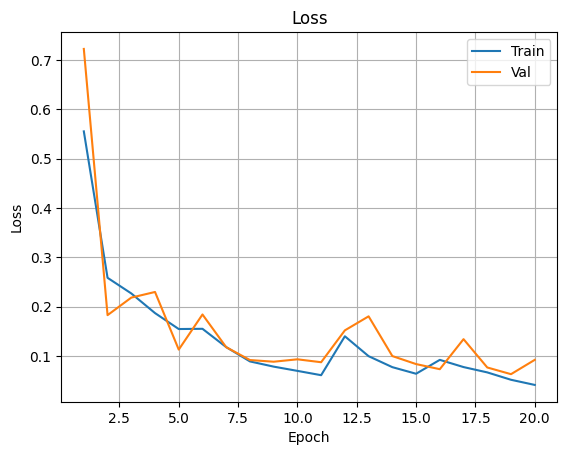

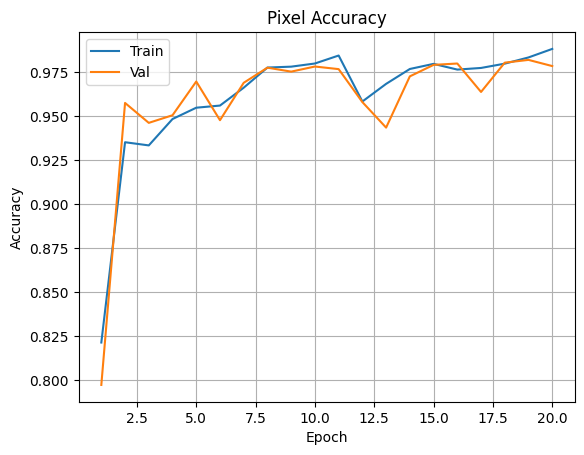

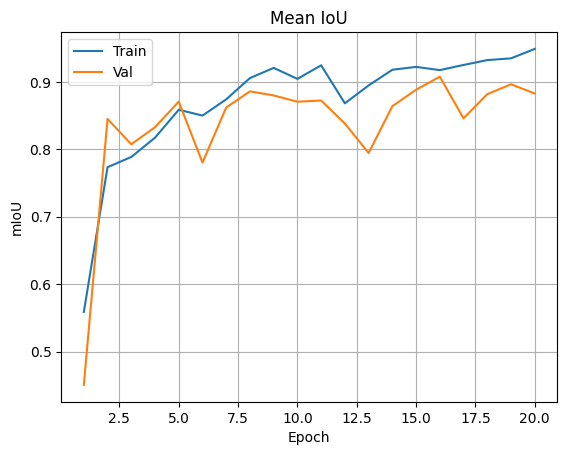

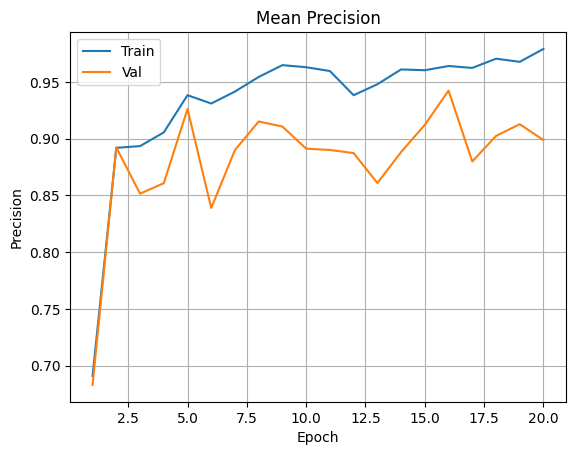

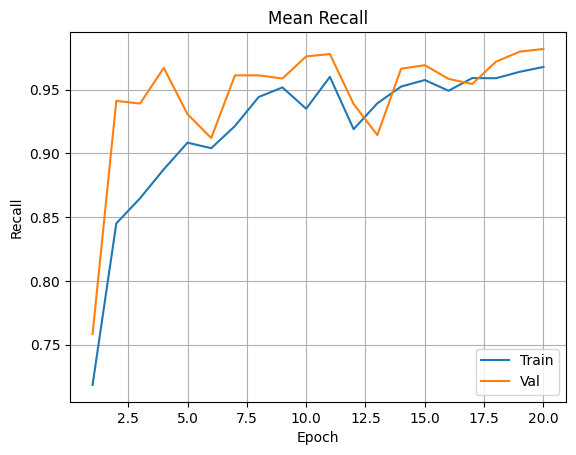

In [ ]:
import matplotlib.pyplot as plt

epochs_range = range(1, EPOCHS + 1)

def plot_metric(train_values, val_values, title, ylabel):
    plt.figure()
    plt.plot(epochs_range, train_values, label="Train")
    plt.plot(epochs_range, val_values, label="Val")
    plt.title(title)
    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.legend()
    plt.grid(True)
    plt.show()

plot_metric(history["train_loss"], history["val_loss"], "Loss", "Loss")
plot_metric(history["train_acc"], history["val_acc"], "Pixel Accuracy", "Accuracy")
plot_metric(history["train_mIoU"], history["val_mIoU"], "Mean IoU", "mIoU")
plot_metric(history["train_precision"], history["val_precision"], "Mean Precision", "Precision")
plot_metric(history["train_recall"], history["val_recall"], "Mean Recall", "Recall")

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs/deeplabv3_segmentation

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 10946), started 0:44:49 ago. (Use '!kill 10946' to kill it.)

<IPython.core.display.Javascript object>

## Inference

In [ ]:
import matplotlib.pyplot as plt
import random

def get_colormap(num_classes):
    base_colors = [
        (0, 0, 0),         # 0 - background (black)
        (255, 0, 0),       # 1 - red
        (0, 255, 0),       # 2 - green
    ]

    colors = []
    for i in range(num_classes):
        colors.append(base_colors[i % len(base_colors)])
    return np.array(colors, dtype=np.uint8)

def colorize_mask(mask_np, colormap):
    h, w = mask_np.shape
    color_mask = colormap[mask_np.reshape(-1)].reshape(h, w, 3)
    return color_mask


def overlay_mask_on_image(image_np, mask_color_np, alpha=0.5):
    if image_np.dtype != np.float32 and image_np.dtype != np.float64:
        image_np = image_np.astype(np.float32) / 255.0

    mask_float = mask_color_np.astype(np.float32) / 255.0

    overlay = (1 - alpha) * image_np + alpha * mask_float
    overlay = np.clip(overlay, 0, 1)
    return overlay


def visualize_random_predictions(model, dataset, device, num_classes, num_samples=10):
    model.eval()
    colormap = get_colormap(num_classes)

    n = len(dataset)
    num_samples = min(num_samples, n)
    indices = random.sample(range(n), num_samples)

    with torch.no_grad():
        for idx in indices:
            image_tensor, mask_tensor = dataset[idx]

            input_tensor = image_tensor.unsqueeze(0).to(device)
            output = model(input_tensor)["out"]
            pred = torch.argmax(output, dim=1).squeeze(0).cpu()

            img_np = image_tensor.permute(1, 2, 0).cpu().numpy()
            gt_mask_np = mask_tensor.cpu().numpy().astype(np.int32)
            pred_mask_np = pred.numpy().astype(np.int32)

            gt_color = colorize_mask(gt_mask_np, colormap)
            pred_color = colorize_mask(pred_mask_np, colormap)

            overlay_pred = overlay_mask_on_image(img_np, pred_color, alpha=0.5)
            plt.figure(figsize=(12, 6))

            plt.subplot(1, 4, 1)
            plt.title("Image")
            plt.imshow(img_np)
            plt.axis("off")

            plt.subplot(1, 4, 2)
            plt.title("GT Mask")
            plt.imshow(gt_color)
            plt.axis("off")

            plt.subplot(1, 4, 3)
            plt.title("Predicted Mask")
            plt.imshow(pred_color)
            plt.axis("off")

            plt.subplot(1, 4, 4)
            plt.title("Overlay (Pred)")
            plt.imshow(overlay_pred)
            plt.axis("off")

            plt.tight_layout()
            plt.show()


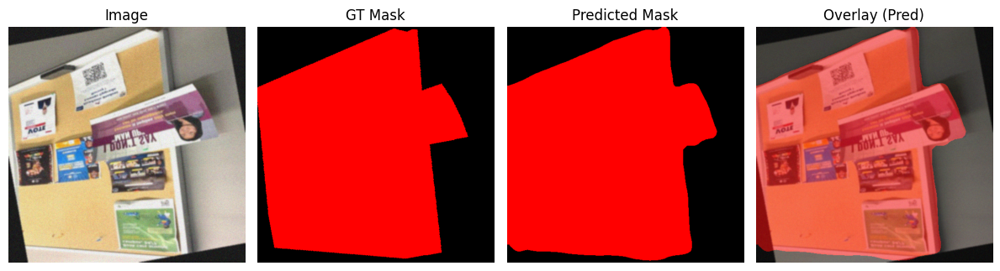

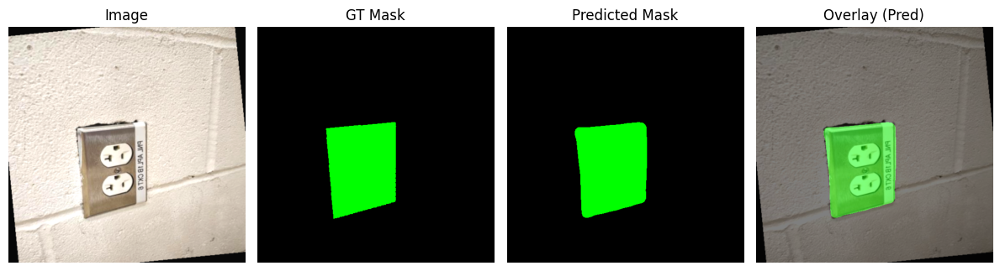

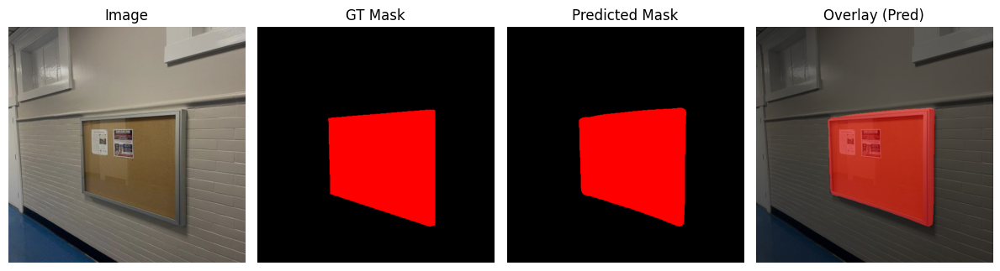

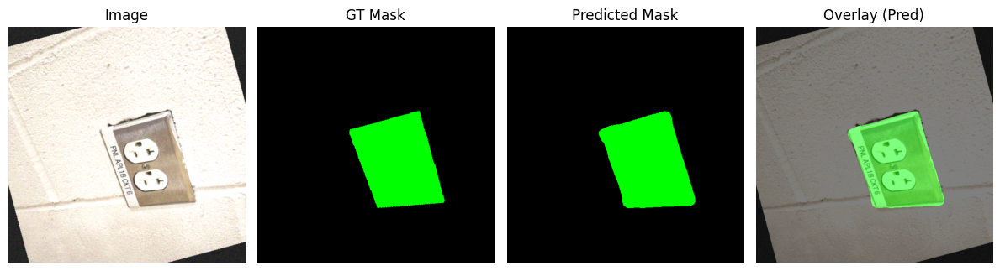

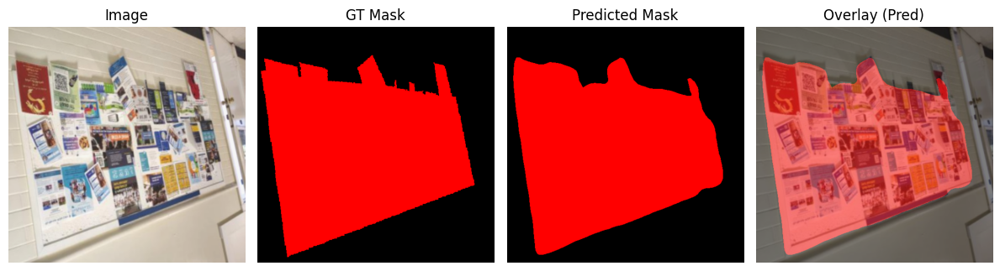

In [ ]:
visualize_random_predictions(
    model=model,
    dataset=val_dataset,
    device=device,
    num_classes=NUM_CLASSES,
    num_samples=5
)

## Hyperparameter Tuning

In [ ]:
import itertools
import math
import random
from copy import deepcopy

random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

HYPERPARAM_SPACE = {
    "learning_rate":   [1e-3, 5e-4, 1e-4],
    "weight_decay":    [0.0, 1e-4, 1e-5],
    "batch_size":      [2, 4],
    "optimizer_type":  ["adam", "sgd"],
    "aug_strength":    ["light", "strong"],
}

def sample_random_config(space):
    config = {}
    for k, v in space.items():
        config[k] = random.choice(v)
    return config

def make_train_transform(strength="light", resize=(512, 512)):
    if strength == "light":
        return SegmentationAugmentations(resize=resize)
    elif strength == "strong":
        return SegmentationAugmentations(resize=resize)
    else:
        return SegmentationAugmentations(resize=resize)

def make_dataloaders(config):
    batch_size = config["batch_size"]

    train_transform = make_train_transform(config["aug_strength"], resize=(512, 512))
    val_transform   = make_train_transform("light", resize=(512, 512))

    train_dataset.transform = train_transform
    val_dataset.transform   = val_transform

    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory=True,
        drop_last=True,
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,
        pin_memory=True,
        drop_last=False,
    )

    return train_loader, val_loader

In [ ]:
from torch.utils.tensorboard import SummaryWriter

def run_trial(trial_id, base_model_fn, config, num_classes, device, epochs_per_trial=5):
    print(f"\n===== Trial {trial_id} with config: {config} =====")
    model = base_model_fn(num_classes)
    model.to(device)

    if config["optimizer_type"].lower() == "adam":
        optimizer = torch.optim.Adam(
            model.parameters(),
            lr=config["learning_rate"],
            weight_decay=config["weight_decay"]
        )
    else:
        optimizer = torch.optim.SGD(
            model.parameters(),
            lr=config["learning_rate"],
            weight_decay=config["weight_decay"],
            momentum=0.9,
            nesterov=True
        )

    criterion = nn.CrossEntropyLoss()
    train_loader, val_loader = make_dataloaders(config)

    log_dir = f"runs/hparam_search/trial_{trial_id}"
    writer = SummaryWriter(log_dir=log_dir)

    best_val_mIoU = -1.0
    best_state_dict = None

    for epoch in range(1, epochs_per_trial + 1):
        train_loss, train_acc, train_mIoU, train_prec, train_rec = train_one_epoch(
            epoch, model, train_loader, optimizer, criterion, device, num_classes
        )
        val_loss, val_acc, val_mIoU, val_prec, val_rec = validate(
            model, val_loader, criterion, device, num_classes
        )

        print(f"[Trial {trial_id}] Epoch {epoch}/{epochs_per_trial}")
        print(f"  Train - Loss: {train_loss:.4f}, Acc: {train_acc*100:.2f}%, mIoU: {train_mIoU:.4f}")
        print(f"  Val   - Loss: {val_loss:.4f}, Acc: {val_acc*100:.2f}%, mIoU: {val_mIoU:.4f}\n")

        # Log to TensorBoard
        writer.add_scalar("Loss/train", train_loss, epoch)
        writer.add_scalar("Loss/val", val_loss, epoch)
        writer.add_scalar("Accuracy/train", train_acc, epoch)
        writer.add_scalar("Accuracy/val", val_acc, epoch)
        writer.add_scalar("mIoU/train", train_mIoU, epoch)
        writer.add_scalar("mIoU/val", val_mIoU, epoch)
        writer.add_scalar("Precision/train", train_prec, epoch)
        writer.add_scalar("Precision/val", val_prec, epoch)
        writer.add_scalar("Recall/train", train_rec, epoch)
        writer.add_scalar("Recall/val", val_rec, epoch)

        if val_mIoU > best_val_mIoU:
            best_val_mIoU = val_mIoU
            best_state_dict = deepcopy(model.state_dict())

    writer.close()
    return best_val_mIoU, best_state_dict

def base_model_fn(num_classes):
    return get_model(num_classes)

## FineTuning the model

In [ ]:
MAX_TRIALS = 5
EPOCHS_PER_TRIAL = 2

best_overall_mIoU = -1.0
best_overall_config = None
best_overall_state = None

for trial_id in range(1, MAX_TRIALS + 1):
    config = sample_random_config(HYPERPARAM_SPACE)

    val_mIoU, state_dict = run_trial(
        trial_id=trial_id,
        base_model_fn=base_model_fn,
        config=config,
        num_classes=NUM_CLASSES,
        device=device,
        epochs_per_trial=EPOCHS_PER_TRIAL
    )

    print(f"Trial {trial_id} finished with best val mIoU = {val_mIoU:.4f}")

    if val_mIoU > best_overall_mIoU:
        best_overall_mIoU = val_mIoU
        best_overall_config = config
        best_overall_state = state_dict
        print(f">>> New best config at trial {trial_id}: {config} (mIoU={val_mIoU:.4f})")

print("\n===== Hyperparameter search complete =====")
print("Best mIoU: ", best_overall_mIoU)
print("Best config: ", best_overall_config)


===== Trial 1 with config: {'learning_rate': 0.0001, 'weight_decay': 0.0, 'batch_size': 2, 'optimizer_type': 'sgd', 'aug_strength': 'light'} =====
Epoch [1] Step [10/83] Loss: 1.1074
Epoch [1] Step [20/83] Loss: 1.0676
Epoch [1] Step [30/83] Loss: 0.9699
Epoch [1] Step [40/83] Loss: 0.8966
Epoch [1] Step [50/83] Loss: 0.8252
Epoch [1] Step [60/83] Loss: 0.7506
Epoch [1] Step [70/83] Loss: 0.7011
Epoch [1] Step [80/83] Loss: 0.6204
[Trial 1] Epoch 1/2
  Train - Loss: 0.9088, Acc: 60.69%, mIoU: 0.2842
  Val   - Loss: 0.7431, Acc: 81.25%, mIoU: 0.4364

Epoch [2] Step [10/83] Loss: 0.8549
Epoch [2] Step [20/83] Loss: 0.5366
Epoch [2] Step [30/83] Loss: 0.5130
Epoch [2] Step [40/83] Loss: 0.5924
Epoch [2] Step [50/83] Loss: 0.8690
Epoch [2] Step [60/83] Loss: 0.4509
Epoch [2] Step [70/83] Loss: 0.6839
Epoch [2] Step [80/83] Loss: 0.5074
[Trial 1] Epoch 2/2
  Train - Loss: 0.5887, Acc: 78.85%, mIoU: 0.3458
  Val   - Loss: 0.5945, Acc: 82.43%, mIoU: 0.4957

Trial 1 finished with best val mIo

In [ ]:
final_model = base_model_fn(NUM_CLASSES).to(device)
final_model.load_state_dict(best_overall_state)

final_config = best_overall_config
print("Fine-tuning with best config:", final_config)
train_loader, val_loader = make_dataloaders(final_config)

# Optimizer
if final_config["optimizer_type"].lower() == "adam":
    optimizer = torch.optim.Adam(
        final_model.parameters(),
        lr=final_config["learning_rate"],
        weight_decay=final_config["weight_decay"]
    )
else:
    optimizer = torch.optim.SGD(
        final_model.parameters(),
        lr=final_config["learning_rate"],
        weight_decay=final_config["weight_decay"],
        momentum=0.9,
        nesterov=True
    )

criterion = nn.CrossEntropyLoss()

# Longer fine-tuning
FINE_TUNE_EPOCHS = 20

history_ft = {
    "train_loss": [],
    "val_loss": [],
    "train_mIoU": [],
    "val_mIoU": [],
}

writer_ft = SummaryWriter(log_dir="runs/final_finetune")

for epoch in range(1, FINE_TUNE_EPOCHS + 1):
    train_loss, train_acc, train_mIoU, train_prec, train_rec = train_one_epoch(
        epoch, final_model, train_loader, optimizer, criterion, device, NUM_CLASSES
    )
    val_loss, val_acc, val_mIoU, val_prec, val_rec = validate(
        final_model, val_loader, criterion, device, NUM_CLASSES
    )

    print(f"[Fine-tune] Epoch {epoch}/{FINE_TUNE_EPOCHS}")
    print(f"  Train - Loss: {train_loss:.4f}, Acc: {train_acc*100:.2f}%, mIoU: {train_mIoU:.4f}")
    print(f"  Val   - Loss: {val_loss:.4f}, Acc: {val_acc*100:.2f}%, mIoU: {val_mIoU:.4f}\n")

    # Save history
    history_ft["train_loss"].append(train_loss)
    history_ft["val_loss"].append(val_loss)
    history_ft["train_mIoU"].append(train_mIoU)
    history_ft["val_mIoU"].append(val_mIoU)

    writer_ft.add_scalar("Loss/train", train_loss, epoch)
    writer_ft.add_scalar("Loss/val", val_loss, epoch)
    writer_ft.add_scalar("mIoU/train", train_mIoU, epoch)
    writer_ft.add_scalar("mIoU/val", val_mIoU, epoch)

torch.save(final_model.state_dict(), "deeplabv3_resnet101_best_finetuned.pth")
writer_ft.close()


Fine-tuning with best config: {'learning_rate': 0.0001, 'weight_decay': 1e-05, 'batch_size': 2, 'optimizer_type': 'adam', 'aug_strength': 'strong'}
Epoch [1] Step [10/83] Loss: 0.1806
Epoch [1] Step [20/83] Loss: 0.2509
Epoch [1] Step [30/83] Loss: 0.1369
Epoch [1] Step [40/83] Loss: 0.3868
Epoch [1] Step [50/83] Loss: 0.1939
Epoch [1] Step [60/83] Loss: 0.3074
Epoch [1] Step [70/83] Loss: 0.1450
Epoch [1] Step [80/83] Loss: 0.1693
[Fine-tune] Epoch 1/20
  Train - Loss: 0.2466, Acc: 92.09%, mIoU: 0.7364
  Val   - Loss: 0.1767, Acc: 95.29%, mIoU: 0.8165

Epoch [2] Step [10/83] Loss: 0.1430
Epoch [2] Step [20/83] Loss: 0.1062
Epoch [2] Step [30/83] Loss: 0.1176
Epoch [2] Step [40/83] Loss: 0.1150
Epoch [2] Step [50/83] Loss: 0.1254
Epoch [2] Step [60/83] Loss: 0.4968
Epoch [2] Step [70/83] Loss: 0.1597
Epoch [2] Step [80/83] Loss: 0.1775
[Fine-tune] Epoch 2/20
  Train - Loss: 0.2085, Acc: 93.63%, mIoU: 0.8059
  Val   - Loss: 0.5138, Acc: 90.52%, mIoU: 0.6771

Epoch [3] Step [10/83] Loss:

## Further enhancing the performance of the model using Automatic Mixed Precision(AMP) and including other metrics like multi class dice loss, mAP, AP and Combine CrossEntropy

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DiceLoss(nn.Module):
    def __init__(self, smooth=1.0):
        super().__init__()
        self.smooth = smooth

    def forward(self, logits, targets):

        probs = torch.softmax(logits, dim=1)
        B, C, H, W = probs.shape
        targets_oh = F.one_hot(targets, num_classes=C)
        targets_oh = targets_oh.permute(0, 3, 1, 2).float()

        dims = (0, 2, 3)

        intersection = (probs * targets_oh).sum(dims)           # [C]
        cardinality  = probs.sum(dims) + targets_oh.sum(dims)   # [C]

        dice_score = (2.0 * intersection + self.smooth) / (cardinality + self.smooth)
        dice_loss = 1.0 - dice_score.mean()

        return dice_loss


class CombinedLoss(nn.Module):
    def __init__(self, ce_weight=1.0, dice_weight=1.0):
        super().__init__()
        self.ce = nn.CrossEntropyLoss()
        self.dice = DiceLoss()
        self.ce_weight = ce_weight
        self.dice_weight = dice_weight

    def forward(self, logits, targets):
        ce_loss = self.ce(logits, targets)
        dice_loss = self.dice(logits, targets)
        total = self.ce_weight * ce_loss + self.dice_weight * dice_loss
        return total, ce_loss, dice_loss

In [ ]:
criterion = CombinedLoss(ce_weight=1.0, dice_weight=1.0)

In [ ]:
import numpy as np

def update_confusion_matrix(conf_mat, preds, targets, num_classes):

    preds = preds.view(-1)
    targets = targets.view(-1)

    mask = (targets >= 0) & (targets < num_classes)
    preds = preds[mask]
    targets = targets[mask]

    indices = targets * num_classes + preds
    conf = torch.bincount(indices, minlength=num_classes**2).reshape(num_classes, num_classes)
    conf_mat += conf
    return conf_mat


def compute_metrics_from_confmat(conf_mat):
    conf = conf_mat.float()
    tp = torch.diag(conf)
    fp = conf.sum(dim=0) - tp
    fn = conf.sum(dim=1) - tp

    pixel_acc = tp.sum() / conf.sum().clamp(min=1)

    iou = tp / (tp + fp + fn).clamp(min=1e-6)
    mean_iou = iou.mean()

    precision = tp / (tp + fp).clamp(min=1e-6)
    mean_precision = precision.mean()

    recall = tp / (tp + fn).clamp(min=1e-6)
    mean_recall = recall.mean()

    return (
        pixel_acc.item(),
        mean_iou.item(),
        mean_precision.item(),
        mean_recall.item(),
    )


In [ ]:
def average_precision_binary(y_true, y_score):

    order = np.argsort(-y_score)
    y_true_sorted = y_true[order]

    tp_cumsum = np.cumsum(y_true_sorted)
    fp_cumsum = np.cumsum(1 - y_true_sorted)

    pos_indices = np.where(y_true_sorted == 1)[0]
    n_pos = y_true.sum()
    if n_pos == 0:
        return 0.0

    precisions = tp_cumsum[pos_indices] / (pos_indices + 1)
    return float(precisions.mean())


def compute_ap_map_from_samples(sampled_scores, sampled_targets, num_classes):

    ap_per_class = []

    for c in range(num_classes):
        if len(sampled_scores[c]) == 0:
            ap_per_class.append(0.0)
            continue

        scores_c = torch.cat(sampled_scores[c], dim=0).cpu().numpy()
        targets_c = torch.cat(sampled_targets[c], dim=0).cpu().numpy()

        ap_c = average_precision_binary(targets_c, scores_c)
        ap_per_class.append(ap_c)

    if len(ap_per_class) == 0:
        return [], 0.0

    mAP = float(np.mean(ap_per_class))
    return ap_per_class, mAP

In [ ]:
from torch.cuda.amp import autocast, GradScaler

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
amp_enabled = (device.type == "cuda")
scaler = GradScaler(enabled=amp_enabled)

`torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.


In [ ]:
from torch.cuda.amp import autocast, GradScaler

def train_one_epoch(epoch, model, loader, optimizer, criterion, device, num_classes,
                    scaler, amp_enabled=True, max_pixels_per_batch=4096):
    model.train()
    running_loss = 0.0

    conf_mat = torch.zeros((num_classes, num_classes), dtype=torch.int64, device=device)

    # for AP/mAP sampling
    sampled_scores = [[] for _ in range(num_classes)]
    sampled_targets = [[] for _ in range(num_classes)]

    for i, (images, masks) in enumerate(loader):
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad(set_to_none=True)

        # ---- AMP forward ----
        with autocast(enabled=amp_enabled):
            outputs = model(images)["out"]
            loss, ce_loss, dice_loss = criterion(outputs, masks)

        # ---- AMP backward ----
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        running_loss += loss.item()

        with torch.no_grad():
            preds = torch.argmax(outputs, dim=1)
            conf_mat = update_confusion_matrix(conf_mat, preds, masks, num_classes)

            probs = torch.softmax(outputs, dim=1)
            B, C, H, W = probs.shape

            probs_flat = probs.view(B, C, -1)
            masks_flat = masks.view(B, -1)
            probs_flat = probs_flat.permute(1, 0, 2).reshape(C, -1)
            masks_flat = masks_flat.reshape(-1)

            sample_k = min(max_pixels_per_batch, masks_flat.numel())
            idx = torch.randint(0, masks_flat.numel(), (sample_k,), device=device)
            masks_s = masks_flat[idx]

            for c in range(num_classes):
                scores_c = probs_flat[c, idx]
                targets_c = (masks_s == c).float()
                sampled_scores[c].append(scores_c.cpu())
                sampled_targets[c].append(targets_c.cpu())

        if (i + 1) % 10 == 0:
            print(f"[Train] Epoch {epoch} Step {i+1}/{len(loader)} Loss: {loss.item():.4f}")

    epoch_loss = running_loss / len(loader)
    pixel_acc, mean_iou, mean_precision, mean_recall = compute_metrics_from_confmat(conf_mat)

    ap_per_class, mAP = compute_ap_map_from_samples(sampled_scores, sampled_targets, num_classes)

    return epoch_loss, pixel_acc, mean_iou, mean_precision, mean_recall, ap_per_class, mAP

In [ ]:
def validate(model, loader, criterion, device, num_classes,
             amp_enabled=True, max_pixels_per_batch=4096):
    model.eval()
    running_loss = 0.0
    conf_mat = torch.zeros((num_classes, num_classes), dtype=torch.int64, device=device)

    sampled_scores = [[] for _ in range(num_classes)]
    sampled_targets = [[] for _ in range(num_classes)]

    with torch.no_grad():
        for images, masks in loader:
            images = images.to(device)
            masks = masks.to(device)

            with autocast(enabled=amp_enabled):
                outputs = model(images)["out"]
                loss, ce_loss, dice_loss = criterion(outputs, masks)

            running_loss += loss.item()

            preds = torch.argmax(outputs, dim=1)
            conf_mat = update_confusion_matrix(conf_mat, preds, masks, num_classes)

            probs = torch.softmax(outputs, dim=1)
            B, C, H, W = probs.shape
            probs_flat = probs.view(B, C, -1)
            masks_flat = masks.view(B, -1)
            probs_flat = probs_flat.permute(1, 0, 2).reshape(C, -1)
            masks_flat = masks_flat.reshape(-1)

            sample_k = min(max_pixels_per_batch, masks_flat.numel())
            idx = torch.randint(0, masks_flat.numel(), (sample_k,), device=device)
            masks_s = masks_flat[idx]

            for c in range(num_classes):
                scores_c = probs_flat[c, idx]
                targets_c = (masks_s == c).float()
                sampled_scores[c].append(scores_c.cpu())
                sampled_targets[c].append(targets_c.cpu())

    val_loss = running_loss / len(loader)
    pixel_acc, mean_iou, mean_precision, mean_recall = compute_metrics_from_confmat(conf_mat)
    ap_per_class, mAP = compute_ap_map_from_samples(sampled_scores, sampled_targets, num_classes)

    return val_loss, pixel_acc, mean_iou, mean_precision, mean_recall, ap_per_class, mAP

In [ ]:
from torch.utils.tensorboard import SummaryWriter

criterion = CombinedLoss(ce_weight=1.0, dice_weight=1.0)
model = get_model(NUM_CLASSES).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scaler = GradScaler(enabled=amp_enabled)

EPOCHS = 20

history_optimized = {
    "train_loss": [], "val_loss": [],
    "train_acc": [], "val_acc": [],
    "train_mIoU": [], "val_mIoU": [],
    "train_precision": [], "val_precision": [],
    "train_recall": [], "val_recall": [],
    "train_mAP":  [], "val_mAP":  [],
    "train_ap_cls": [], "val_ap_cls": [],
}

writer_opt = SummaryWriter(log_dir="runs/optimized_amp")

for epoch in range(1, EPOCHS + 1):
    train_loss, train_acc, train_mIoU, train_prec, train_rec, train_ap_cls, train_mAP = train_one_epoch(
        epoch, model, train_loader, optimizer, criterion, device, NUM_CLASSES,
        scaler=scaler, amp_enabled=amp_enabled
    )

    val_loss, val_acc, val_mIoU, val_prec, val_rec, val_ap_cls, val_mAP = validate(
        model, val_loader, criterion, device, NUM_CLASSES, amp_enabled=amp_enabled
    )

    print(f"\n[OPT] Epoch {epoch}/{EPOCHS}")
    print(f"Train - Loss: {train_loss:.4f}, mIoU: {train_mIoU:.4f}, Acc: {train_acc:.4f}, mAP: {train_mAP:.4f}, Prec: {train_prec:.4f}, Rec: {train_rec:.4f}")
    print(f"Val   - Loss: {val_loss:.4f}, mIoU: {val_mIoU:.4f}, Acc: {val_acc:.4f}, mAP: {val_mAP:.4f}, Prec: {val_prec:.4f}, Rec: {val_rec:.4f}")
    print(f"Val AP per class: {['{:.3f}'.format(x) for x in val_ap_cls]}")

    history_optimized["train_loss"].append(train_loss)
    history_optimized["val_loss"].append(val_loss)
    history_optimized["train_mIoU"].append(train_mIoU)
    history_optimized["val_mIoU"].append(val_mIoU)
    history_optimized["train_mAP"].append(train_mAP)
    history_optimized["val_mAP"].append(val_mAP)
    history_optimized["train_acc"].append(train_acc)
    history_optimized["val_acc"].append(val_acc)
    history_optimized["train_precision"].append(train_prec)
    history_optimized["val_precision"].append(val_prec)
    history_optimized["train_recall"].append(train_rec)
    history_optimized["val_recall"].append(val_rec)

    # TensorBoard
    writer_opt.add_scalar("Loss/train", train_loss, epoch)
    writer_opt.add_scalar("Loss/val",   val_loss,  epoch)
    writer_opt.add_scalar("mIoU/train", train_mIoU, epoch)
    writer_opt.add_scalar("mIoU/val",   val_mIoU,   epoch)
    writer_opt.add_scalar("mAP/train",  train_mAP,  epoch)
    writer_opt.add_scalar("mAP/val",    val_mAP,    epoch)
    writer_opt.add_scalar("Acc/train", train_acc, epoch)
    writer_opt.add_scalar("Acc/val", val_acc, epoch)
    writer_opt.add_scalar("Prec/train", train_prec, epoch)
    writer_opt.add_scalar("Prec/val", val_prec, epoch)
    writer_opt.add_scalar("Rec/train", train_rec, epoch)
    writer_opt.add_scalar("Rec/val", val_rec, epoch)

writer_opt.close()
torch.save(model.state_dict(), "deeplabv3_resnet101_optimized_amp_optimized.pth")

`torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
`torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.


[Train] Epoch 1 Step 10/83 Loss: 1.8412
[Train] Epoch 1 Step 20/83 Loss: 0.8961
[Train] Epoch 1 Step 30/83 Loss: 0.9703
[Train] Epoch 1 Step 40/83 Loss: 1.4860
[Train] Epoch 1 Step 50/83 Loss: 0.7312
[Train] Epoch 1 Step 60/83 Loss: 1.1105
[Train] Epoch 1 Step 70/83 Loss: 1.1499
[Train] Epoch 1 Step 80/83 Loss: 0.9074


`torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.



[OPT] Epoch 1/20
Train - Loss: 1.0795, mIoU: 0.5714, Acc: 0.8333, mAP: 0.7571, Prec: 0.6888, Rec: 0.7388
Val   - Loss: 1.0145, mIoU: 0.6416, Acc: 0.8865, mAP: 0.9053, Prec: 0.7223, Rec: 0.8922
Val AP per class: ['0.985', '0.910', '0.821']
[Train] Epoch 2 Step 10/83 Loss: 0.6763
[Train] Epoch 2 Step 20/83 Loss: 0.7873
[Train] Epoch 2 Step 30/83 Loss: 0.9550
[Train] Epoch 2 Step 40/83 Loss: 0.3434
[Train] Epoch 2 Step 50/83 Loss: 0.4084
[Train] Epoch 2 Step 60/83 Loss: 0.7246
[Train] Epoch 2 Step 70/83 Loss: 0.5677
[Train] Epoch 2 Step 80/83 Loss: 0.3206

[OPT] Epoch 2/20
Train - Loss: 0.6774, mIoU: 0.7447, Acc: 0.9188, mAP: 0.8830, Prec: 0.8465, Rec: 0.8536
Val   - Loss: 0.6647, mIoU: 0.7734, Acc: 0.9388, mAP: 0.9075, Prec: 0.8884, Rec: 0.8430
Val AP per class: ['0.987', '0.958', '0.777']
[Train] Epoch 3 Step 10/83 Loss: 0.5306
[Train] Epoch 3 Step 20/83 Loss: 0.3324
[Train] Epoch 3 Step 30/83 Loss: 0.5472
[Train] Epoch 3 Step 40/83 Loss: 0.6175
[Train] Epoch 3 Step 50/83 Loss: 0.4442


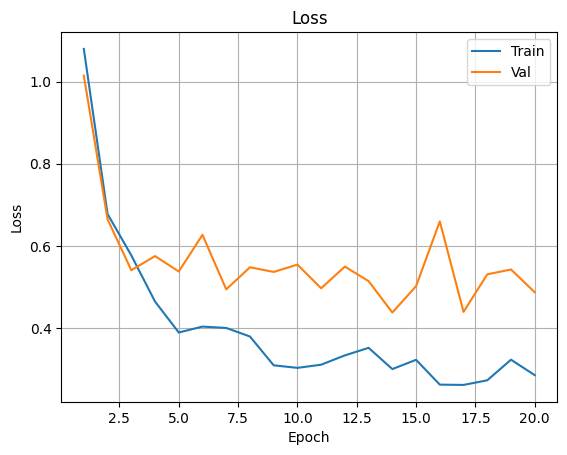

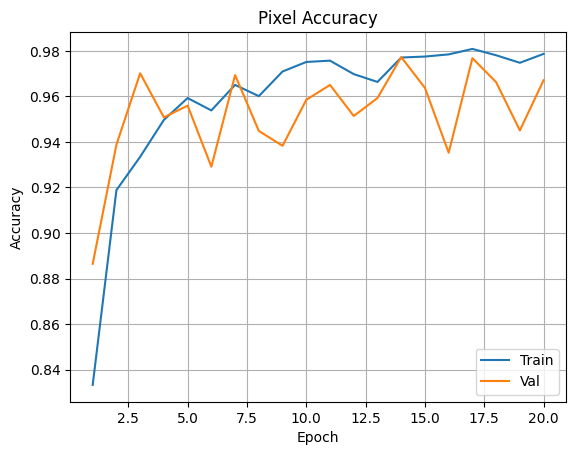

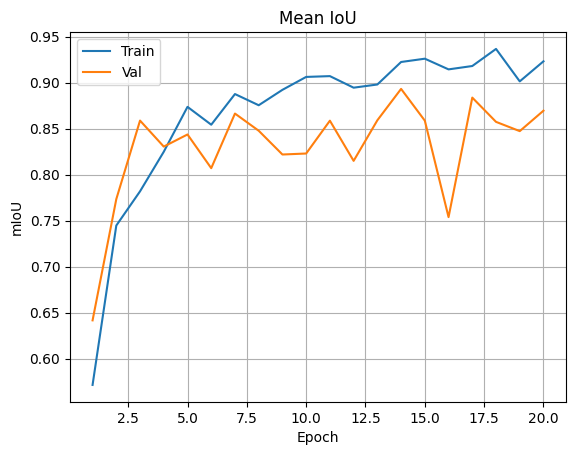

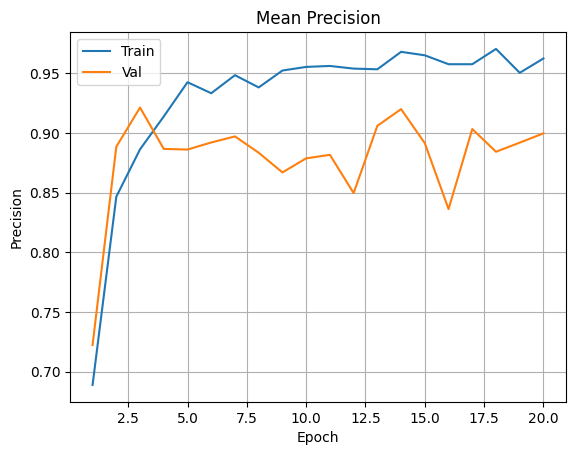

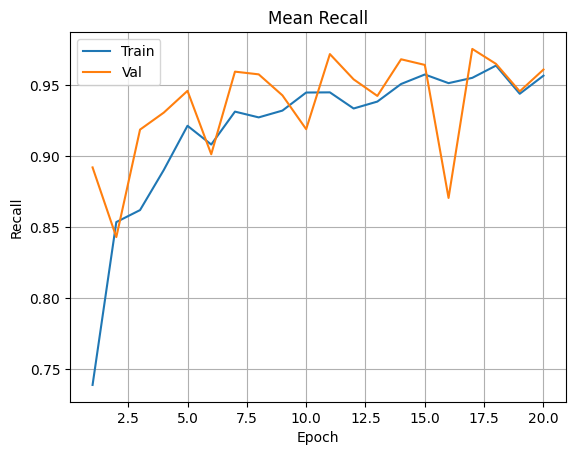

In [ ]:
import matplotlib.pyplot as plt

epochs_range = range(1, EPOCHS + 1)

def plot_metric(train_values, val_values, title, ylabel):
    plt.figure()
    plt.plot(epochs_range, train_values, label="Train")
    plt.plot(epochs_range, val_values, label="Val")
    plt.title(title)
    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.legend()
    plt.grid(True)
    plt.show()

plot_metric(history_optimized["train_loss"], history_optimized["val_loss"], "Loss", "Loss")
plot_metric(history_optimized["train_acc"], history_optimized["val_acc"], "Pixel Accuracy", "Accuracy")
plot_metric(history_optimized["train_mIoU"], history_optimized["val_mIoU"], "Mean IoU", "mIoU")
plot_metric(history_optimized["train_precision"], history_optimized["val_precision"], "Mean Precision", "Precision")
plot_metric(history_optimized["train_recall"], history_optimized["val_recall"], "Mean Recall", "Recall")

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
import matplotlib.pyplot as plt
import random

def get_colormap(num_classes):
    base_colors = [
        (0, 0, 0),         # 0 - background (black)
        (255, 0, 0),       # 1 - red
        (0, 255, 0),       # 2 - green
    ]

    colors = []
    for i in range(num_classes):
        colors.append(base_colors[i % len(base_colors)])
    return np.array(colors, dtype=np.uint8)

def colorize_mask(mask_np, colormap):
    h, w = mask_np.shape
    color_mask = colormap[mask_np.reshape(-1)].reshape(h, w, 3)
    return color_mask


def overlay_mask_on_image(image_np, mask_color_np, alpha=0.5):
    if image_np.dtype != np.float32 and image_np.dtype != np.float64:
        image_np = image_np.astype(np.float32) / 255.0

    mask_float = mask_color_np.astype(np.float32) / 255.0

    overlay = (1 - alpha) * image_np + alpha * mask_float
    overlay = np.clip(overlay, 0, 1)
    return overlay


def visualize_random_predictions(model, dataset, device, num_classes, num_samples=10):
    model.eval()
    colormap = get_colormap(num_classes)

    n = len(dataset)
    num_samples = min(num_samples, n)
    indices = random.sample(range(n), num_samples)

    with torch.no_grad():
        for idx in indices:
            image_tensor, mask_tensor = dataset[idx]

            input_tensor = image_tensor.unsqueeze(0).to(device)
            output = model(input_tensor)["out"]
            pred = torch.argmax(output, dim=1).squeeze(0).cpu()

            img_np = image_tensor.permute(1, 2, 0).cpu().numpy()
            gt_mask_np = mask_tensor.cpu().numpy().astype(np.int32)
            pred_mask_np = pred.numpy().astype(np.int32)

            gt_color = colorize_mask(gt_mask_np, colormap)
            pred_color = colorize_mask(pred_mask_np, colormap)

            overlay_pred = overlay_mask_on_image(img_np, pred_color, alpha=0.5)
            plt.figure(figsize=(12, 6))

            plt.subplot(1, 4, 1)
            plt.title("Image")
            plt.imshow(img_np)
            plt.axis("off")

            plt.subplot(1, 4, 2)
            plt.title("GT Mask")
            plt.imshow(gt_color)
            plt.axis("off")

            plt.subplot(1, 4, 3)
            plt.title("Predicted Mask")
            plt.imshow(pred_color)
            plt.axis("off")

            plt.subplot(1, 4, 4)
            plt.title("Overlay (Pred)")
            plt.imshow(overlay_pred)
            plt.axis("off")

            plt.tight_layout()
            plt.show()


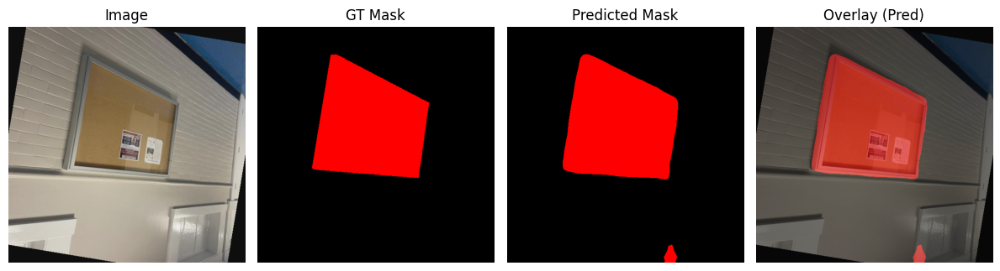

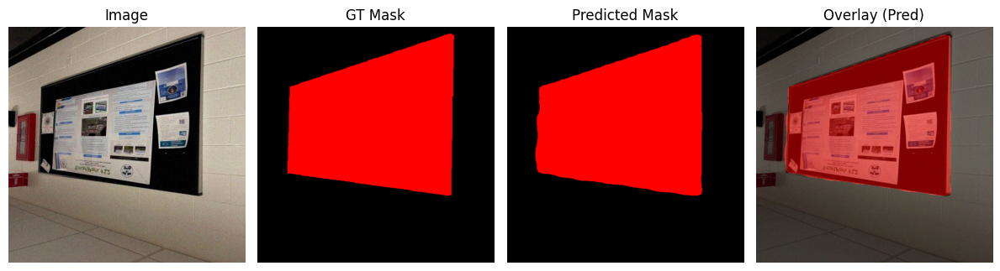

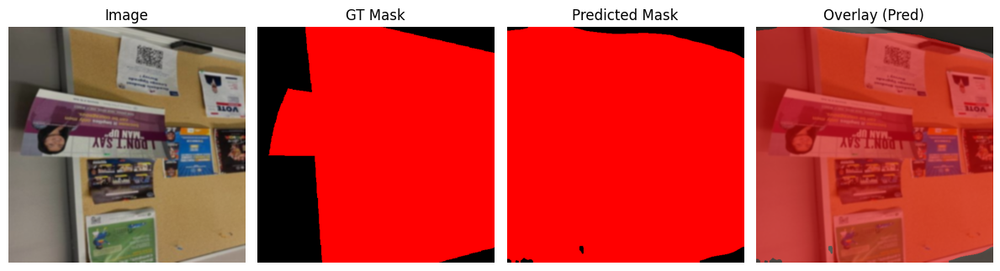

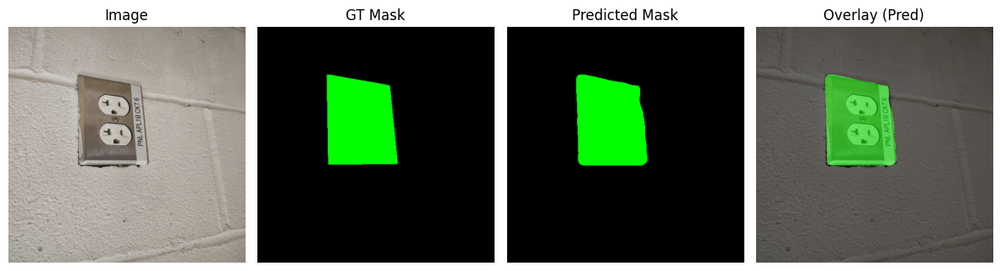

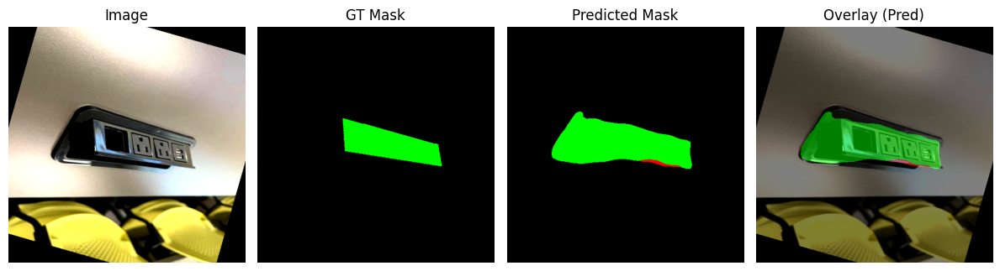

In [ ]:
visualize_random_predictions(
    model=model,
    dataset=val_dataset,
    device=device,
    num_classes=NUM_CLASSES,
    num_samples=5
)

In [ ]:
!zip -r runs.zip /content/runs
from google.colab import files
files.download("runs.zip")

  adding: content/runs/ (stored 0%)
  adding: content/runs/final_finetune/ (stored 0%)
  adding: content/runs/final_finetune/events.out.tfevents.1764347371.7d8df6933f4f.467.8 (deflated 63%)
  adding: content/runs/deeplabv3_segmentation/ (stored 0%)
  adding: content/runs/deeplabv3_segmentation/events.out.tfevents.1764353199.7d8df6933f4f.467.15 (deflated 55%)
  adding: content/runs/deeplabv3_segmentation/.ipynb_checkpoints/ (stored 0%)
  adding: content/runs/hparam_search/ (stored 0%)
  adding: content/runs/hparam_search/trial_5/ (stored 0%)
  adding: content/runs/hparam_search/trial_5/events.out.tfevents.1764346739.7d8df6933f4f.467.7 (deflated 50%)
  adding: content/runs/hparam_search/trial_1/ (stored 0%)
  adding: content/runs/hparam_search/trial_1/events.out.tfevents.1764345904.7d8df6933f4f.467.2 (deflated 9%)
  adding: content/runs/hparam_search/trial_1/events.out.tfevents.1764345858.7d8df6933f4f.467.1 (deflated 9%)
  adding: content/runs/hparam_search/trial_1/events.out.tfevents.17

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>